In [4]:
!octopus > out_gs.log 2>&1

In [6]:
!head -n 20 out_gs.log  # Just to see the first 20 lines of the octopus output

    <><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><>
                                ___
                             .-'   `'.
                            /         \
                            |         ;
                            |         |           ___.--,
                   _.._     |0) ~ (0) |    _.---'`__.-( (_.
            __.--'`_.. '.__.\    '--. \_.-' ,.--'`     `""`
           ( ,.--'`   ',__ /./;   ;, '.__.'`    __
           _`) )  .---.__.' / |   |\   \__..--""  """--.,_
          `---' .'.''-._.-'`_./  /\ '.  \ _.-~~~````~~~-._`-.__.'
                | |  .' _.-' |  |  \  \  '.               `~---`
                 \ \/ .'     \  \   '. '-._)
                  \/ /        \  \    `=.__`~-.
             jgs  / /\         `) )    / / `"".`\
            , _.-'.'\ \        / /    ( (     / /
             `--~`   ) )    .-'.'      '.'.  | (
                    (/`    ( (`          ) )  '-;
                     `      '-;         (-'



In [7]:
!tail -n 20 out_gs.log  # Just to see the last 20 lines of the octopus output

             Info: Writing states. 2023/11/24 at 13:51:23


        Info: Finished writing states. 2023/11/24 at 13:51:23

Info: SCF converged in   18 iterations


** Warning:
**   Some of the states are not fully converged!

Info: Number of matrix-vector products:       2893
Info: Writing output to static/
Info: Finished writing information to 'restart/gs'.

             Calculation ended on 2023/11/24 at 13:51:30

                        Walltime:  01m 17.222s

Octopus emitted 1 warning.


In [9]:
# First import all the python modules we might need for the analysis.
import os
from pathlib import Path
import shutil

import matplotlib.pyplot as plt
import numpy as np
from postopus import Run

%matplotlib inline


In [11]:
run = Run(".")  # or equivalent run = Run()

In [12]:
run.default.system_data.keys()

dict_keys(['scf'])

In [13]:
run.default.scf.info

['\n',
 '******************************** Grid ********************************\n',
 'Simulation Box:\n',
 '  Type = minimum\n',
 '  Radius  [A] =   5.000\n',
 'Main mesh:\n',
 '  Spacing [A] = ( 0.150, 0.150, 0.150)    volume/point [A^3] =      0.00337\n',
 '  # inner mesh =     371891\n',
 '  # total mesh =     468887\n',
 '  Grid Cutoff [eV] =  1671.245006    Grid Cutoff [Ry] =   122.834253\n',
 '**********************************************************************\n',
 '\n',
 '\n',
 '***************************** Symmetries *****************************\n',
 'Symmetry elements : (i) 3*(C2) 3*(sigma)\n',
 'Symmetry group    : D2h\n',
 '**********************************************************************\n',
 '\n',
 '\n',
 '**************************** Theory Level ****************************\n',
 'Input: [TheoryLevel = kohn_sham]\n',
 '\n',
 'Exchange-correlation:\n',
 '  Exchange\n',
 '    Slater exchange (LDA)\n',
 '    [1] P. A. M. Dirac.,  Math. Proc. Cambridge Philos. Soc. 

In [14]:
run.default.scf.convergence

,energy,energy_diff,abs_dens,rel_dens,abs_ev,rel_ev
#iter,,,,,,
1,-1266.190200,1266.190000,6.576180,2.192060e-01,24.450600,0.046511
2,-1186.520460,79.669700,0.727948,2.426490e-02,71.843300,0.158295
3,-946.223044,240.297000,2.574550,8.581830e-02,134.692000,0.422013
4,-1066.187200,119.964000,1.242080,4.140260e-02,72.970200,0.186084
5,-1060.009480,6.177720,0.168403,5.613440e-03,10.448500,0.027374
6,-1029.953510,30.056000,0.331031,1.103440e-02,15.929200,0.043551
7,-1018.415620,11.537900,0.136618,4.553930e-03,4.685710,0.012977
8,-1024.290050,5.874430,0.065752,2.191730e-03,3.171390,0.008707
9,-1028.836080,4.546030,0.049665,1.655490e-03,2.256290,0.006156


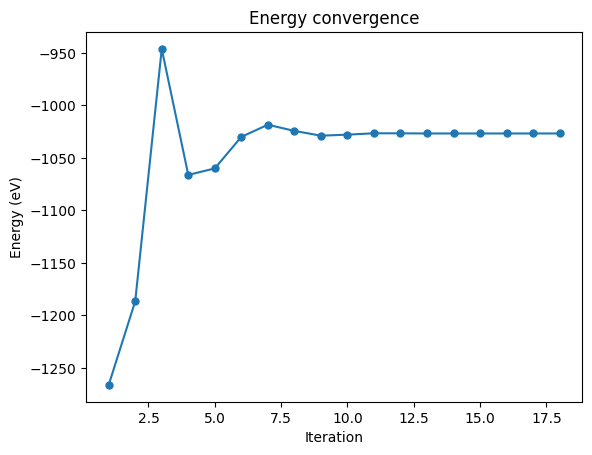

In [15]:
# Plot of energy at each interaction showing its convergence
fig = run.default.scf.convergence["energy"].plot(
    title="Energy convergence",
    marker=".",
    markersize=10,
)
fig.set(xlabel="Iteration", ylabel="Energy (eV)");



In [16]:
run.default.scf.convergence.attrs

{'units': {}, 'metadata': {'filename': 'convergence'}}

In [17]:
density_data = run.default.scf.density.get(steps=1)
density_data

<xarray.DataArray 'density' (step: 1, x: 95, y: 99, z: 67)>
array([[[[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
...
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]]]])
Coordinates:
  * step     (step) int64 1
  * x        (x) float64 -13.32 -13.04 -12.76 -12.47 ... 12.47 12.76 13.04 13.32
  * y        (y) float64 -13.89 -13.61 -13.32 -13.04 ... 13.04 13.32 13.61 13.89
  * z        (z) float64 -9.354 -9.071 -8.787 -8.504 ... 8.504 8.787 9.071 9.354
Attributes:
    units:    au

In [18]:
density_data.coords

Coordinates:
  * step     (step) int64 1
  * x        (x) float64 -13.32 -13.04 -12.76 -12.47 ... 12.47 12.76 13.04 13.32
  * y        (y) float64 -13.89 -13.61 -13.32 -13.04 ... 13.04 13.32 13.61 13.89
  * z        (z) float64 -9.354 -9.071 -8.787 -8.504 ... 8.504 8.787 9.071 9.354

In [19]:
# ask postopus for the x-array representation of the data
density = run.default.scf.density
xa = density.get_converged()  # the converged field from the "static" folder is loaded.
xa

 

<xarray.DataArray 'density' (step: 1, x: 95, y: 99, z: 67)>
array([[[[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
...
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]]]])
Coordinates:
  * step     (step) int64 1
  * x        (x) float64 -13.32 -13.04 -12.76 -12.47 ... 12.47 12.76 13.04 13.32
  * y        (y) float64 -13.89 -13.61 -13.32 -13.04 ... 13.04 13.32 13.61 13.89
  * z        (z) float64 -9.354 -9.071 -8.787 -8.504 ... 8.504 8.787 9.071 9.354
Attributes:
    units:    au

In [22]:
s0 = xa.isel(z=33)  # Viewing the slice at 33rd index of z-axis
s0



<xarray.DataArray 'density' (step: 1, x: 95, y: 99)>
array([[[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]]])
Coordinates:
  * step     (step) int64 1
  * x        (x) float64 -13.32 -13.04 -12.76 -12.47 ... 12.47 12.76 13.04 13.32
  * y        (y) float64 -13.89 -13.61 -13.32 -13.04 ... 13.04 13.32 13.61 13.89
    z        float64 3e-06
Attributes:
    units:    au

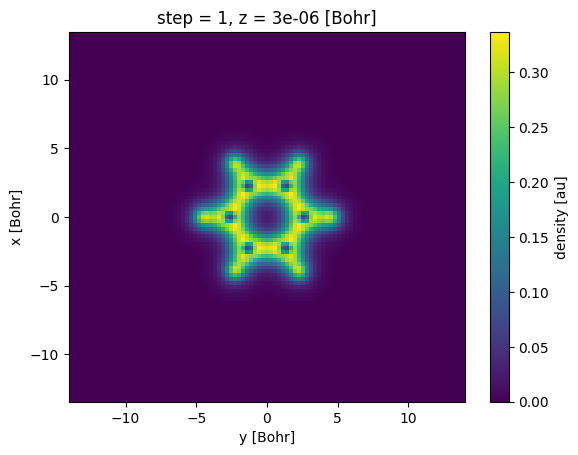

In [23]:
s0.plot()

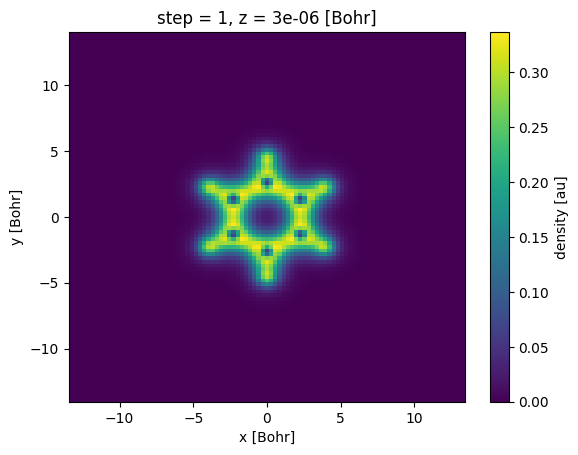

In [24]:
s0.plot(x="x")

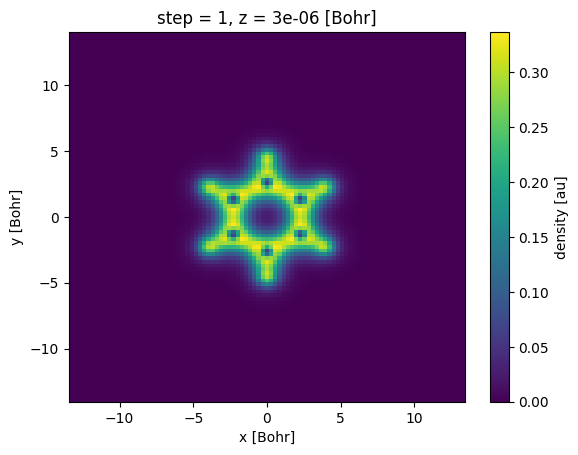

In [25]:
s1 = xa.sel(z=0, method="nearest")
s1.plot(x="x")



In [26]:
xa.sel(x=0, method='nearest')

<xarray.DataArray 'density' (step: 1, y: 99, z: 67)>
array([[[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]]])
Coordinates:
  * step     (step) int64 1
    x        float64 4e-06
  * y        (y) float64 -13.89 -13.61 -13.32 -13.04 ... 13.04 13.32 13.61 13.89
  * z        (z) float64 -9.354 -9.071 -8.787 -8.504 ... 8.504 8.787 9.071 9.354
Attributes:
    units:    au

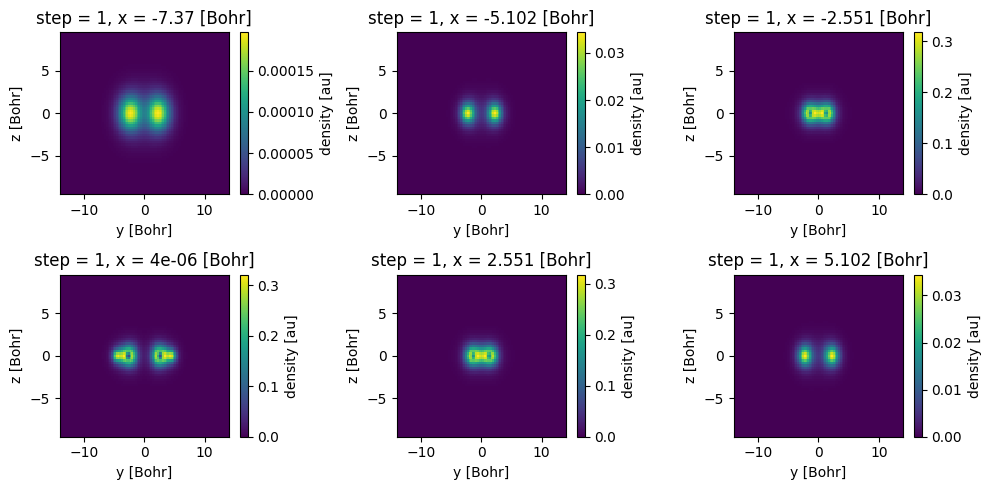

In [27]:
# plot of 6 2D slice of the density along the x axis
fig, axs = plt.subplots(
    2, 3, figsize=(10, 5)
)  # create a subplot with 2 rows, 3 columns
x_positions = np.linspace(-7.5, 5, 6)  # x positions from -7.5 to 5 in 6 steps
for ax, x in zip(axs.flat, x_positions):
    xa.sel(x=x, method="nearest").plot(
        ax=ax, x="y"
    )  # plot the slice nearest to x position

fig.tight_layout()  # avoid overlap of labels

In [28]:
xa.sel(x=0, z=0, method='nearest')

<xarray.DataArray 'density' (step: 1, y: 99)>
array([[2.20834e-10, 1.06798e-09, 2.81173e-09, 6.00039e-09, 1.16268e-08,
        2.14323e-08, 3.84536e-08, 6.79877e-08, 1.19305e-07, 2.08684e-07,
        3.64831e-07, 6.38583e-07, 1.12038e-06, 1.97186e-06, 3.48343e-06,
        6.17947e-06, 1.10122e-05, 1.97207e-05, 3.55009e-05, 6.42645e-05,
        1.17024e-04, 2.14449e-04, 3.95663e-04, 7.35395e-04, 1.37789e-03,
        2.60497e-03, 4.97481e-03, 9.60995e-03, 1.88117e-02, 3.76064e-02,
        7.79282e-02, 1.52590e-01, 2.38442e-01, 2.99432e-01, 3.12624e-01,
        2.93651e-01, 2.98162e-01, 3.20413e-01, 2.73557e-01, 1.11426e-01,
        6.69252e-02, 2.08795e-01, 2.80099e-01, 2.24955e-01, 1.53582e-01,
        9.83731e-02, 6.19309e-02, 4.01196e-02, 2.88428e-02, 2.53868e-02,
        2.88428e-02, 4.01196e-02, 6.19309e-02, 9.83731e-02, 1.53582e-01,
        2.24955e-01, 2.80099e-01, 2.08795e-01, 6.69252e-02, 1.11426e-01,
        2.73557e-01, 3.20413e-01, 2.98162e-01, 2.93651e-01, 3.12624e-01,
        2.99432e-01, 2.38442e-01, 1.52590e-01, 7.79282e-02, 3.76064e-02,
        1.88117e-02, 9.60995e-03, 4.97481e-03, 2.60497e-03, 1.37789e-03,
        7.35395e-04, 3.95663e-04, 2.14449e-04, 1.17024e-04, 6.42645e-05,
        3.55009e-05, 1.97207e-05, 1.10122e-05, 6.17947e-06, 3.48343e-06,
        1.97186e-06, 1.12038e-06, 6.38583e-07, 3.64831e-07, 2.08684e-07,
        1.19305e-07, 6.79877e-08, 3.84536e-08, 2.14323e-08, 1.16268e-08,
        6.00039e-09, 2.81173e-09, 1.06798e-09, 2.20834e-10]])
Coordinates:
  * step     (step) int64 1
    x        float64 4e-06
  * y        (y) float64 -13.89 -13.61 -13.32 -13.04 ... 13.04 13.32 13.61 13.89
    z        float64 3e-06
Attributes:
    units:    au

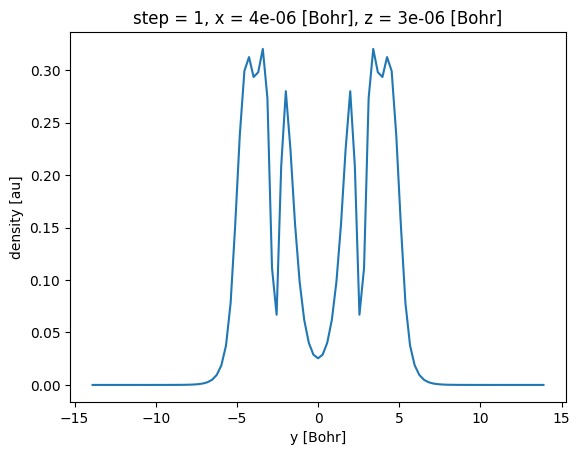

In [29]:
xa.sel(x=0, z=0, method="nearest").plot()



<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
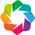

In [30]:
import holoviews as hv
from holoviews import opts  # For setting defaults

# hv.extension('bokeh', 'matplotlib')  # Allow for interactive plots
hv.extension("bokeh")  # Allow for interactive plots



In [31]:
# Choose color scheme similar to matplotlib
opts.defaults(
    opts.Image(cmap="viridis", width=400, height=400),
)

In [33]:
run = Run("")
xa = run.default.scf.density.get_converged()

In [34]:
hv.Dataset(xa)

:Dataset   [step,x,y,z]   (density)

In [35]:
hv.Dataset(xa).to(hv.Image, ['x', 'y'])

:HoloMap   [step,z]
   :Image   [x,y]   (density)

In [36]:
hv.Dataset(xa).to(hv.Image, kdims=["x", "y"]).opts(colorbar=True, width=500)

:HoloMap   [step,z]
   :Image   [x,y]   (density)

In [37]:
# Note for web users: You should have an active notebook session to interact with the plot
hv.Dataset(xa).to(hv.Image, kdims=["y", "z"], dynamic=True).opts(
    colorbar=True, width=500
)

ModuleNotFoundError: No module named 'jupyter_bokeh'

:DynamicMap   [step,x]

In [38]:
density = run.default.scf.density
xa = density.get_converged(source="cube")


In [39]:
xa.coords

Coordinates:
  * step     (step) int64 1
  * x        (x) float64 -13.32 -13.04 -12.76 -12.47 ... 12.47 12.76 13.04 13.32
  * y        (y) float64 -13.89 -13.61 -13.32 -13.04 ... 13.04 13.32 13.61 13.89
  * z        (z) float64 -9.354 -9.071 -8.787 -8.504 ... 8.504 8.787 9.071 9.354

In [40]:
xa.values.shape

(1, 95, 99, 67)

In [41]:
s0 = xa.isel(z=16)

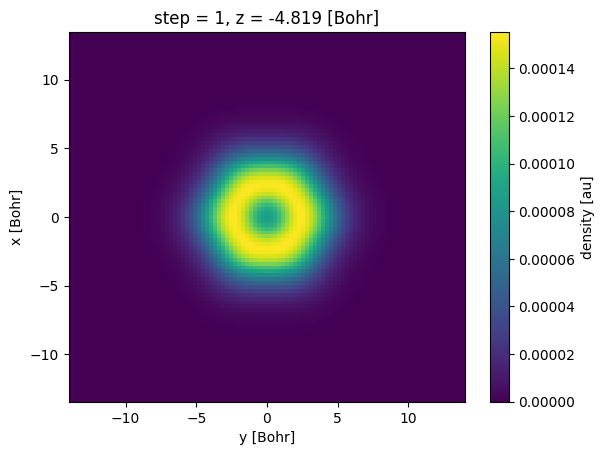

In [42]:
s0.plot()

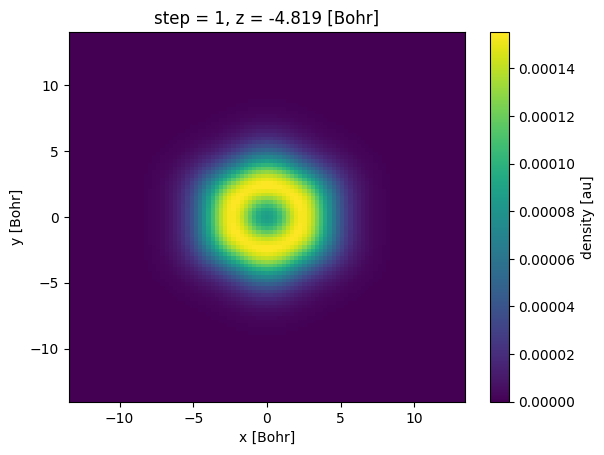

In [43]:
s0.plot(x="x")

In [44]:
xa = xa.squeeze()  # only one step, squeeze this dimension.

In [45]:
s1 = xa.sel(z=0, method="nearest")

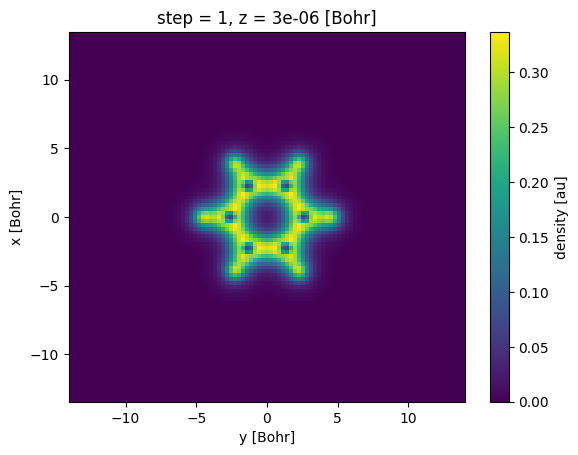

In [46]:
s1.plot()

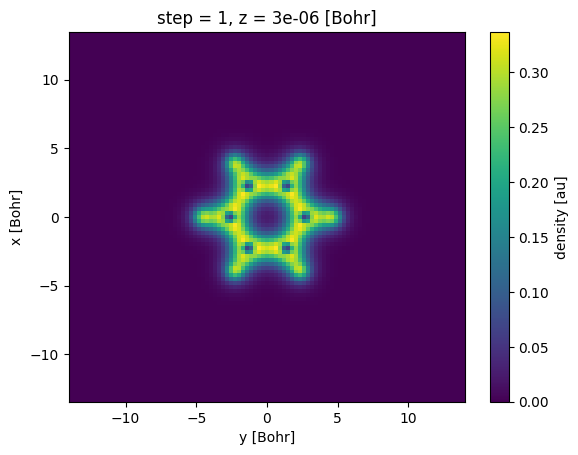

In [47]:
s1.plot.imshow()

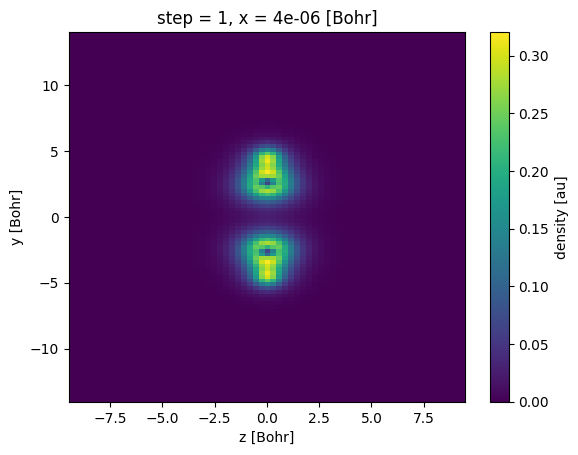

In [48]:
s2 = xa.sel(x=0, method="nearest")
s2.plot.imshow()

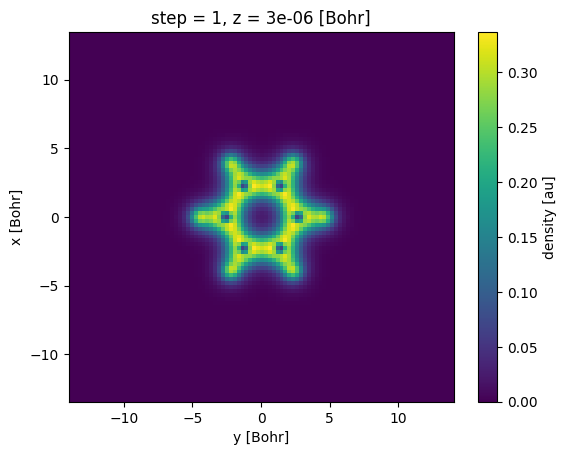

In [49]:
fig, ax = plt.subplots()
s1.plot.imshow(ax=ax)
ax.set_aspect("equal")

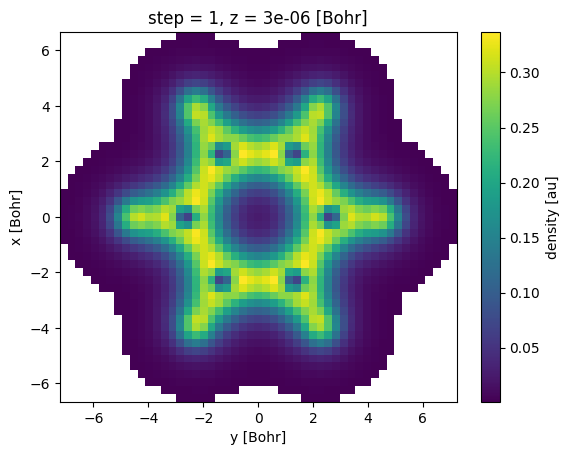

In [50]:
s2 = xa.where(xa > 0.001, drop=True).sel(z=0, method="nearest")
s2.plot()


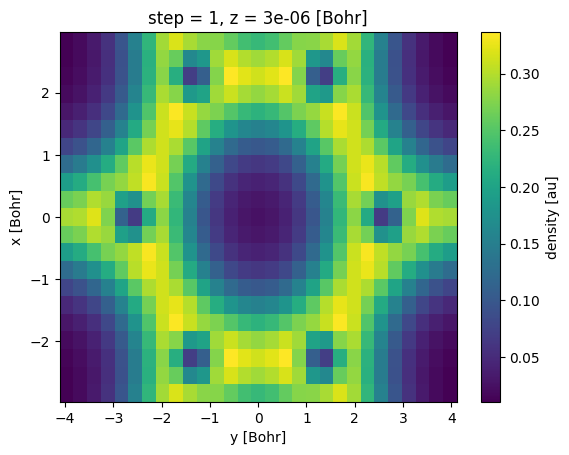

In [51]:
s3 = xa.where((abs(xa.x) <= 3) & (abs(xa.y) <= 4), drop=True).sel(z=0, method="nearest")
s3.plot()



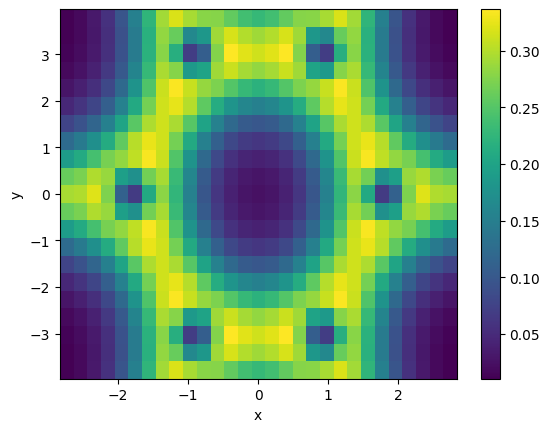

In [52]:
fig, ax = plt.subplots()

# figure out the data (d) and coordinates (x, y):
d = s3
x = s3.coords["x"].values
y = s3.coords["y"].values

# create the actual image, with `magma` colour map
p = ax.imshow(d, extent=[x.min(), x.max(), y.min(), y.max()], aspect="auto")
ax.set_xlabel("x")
ax.set_ylabel("y")

# add colour bar
fig.colorbar(p)



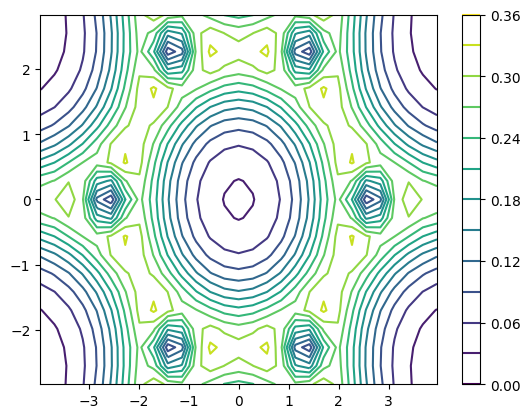

In [53]:
fig, ax = plt.subplots()

# contour needs x and y coordinates on matrices X and Y with the same dimensions as the data
Y, X = np.meshgrid(x, y, indexing="ij")

p2 = ax.contour(X, Y, d, levels=10)
fig.colorbar(p2)

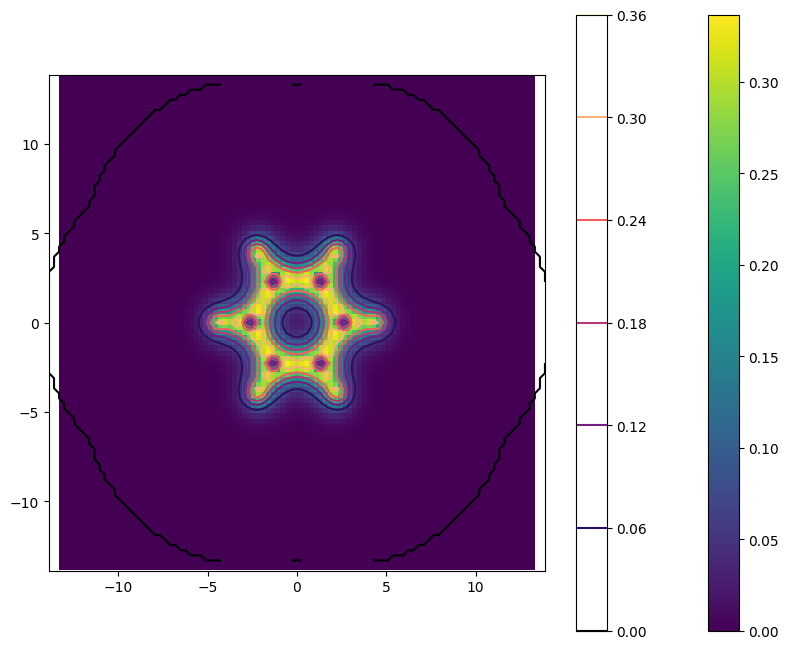

In [54]:
fig, ax = plt.subplots(figsize=(10, 8))

z = xa.sel(z=0, method="nearest")
x = xa.coords["x"].values
y = xa.coords["y"].values
p = ax.imshow(
    z,
    vmin=z.min(),
    vmax=z.max(),
    extent=[x.min(), x.max(), y.min(), y.max()],
    interpolation="nearest",
    aspect="equal",
    alpha=1,
)
fig.colorbar(p)

Y, X = np.meshgrid(x, y, indexing="ij")
p2 = ax.contour(X, Y, z, cmap="magma", levels=5)
fig.colorbar(p2)

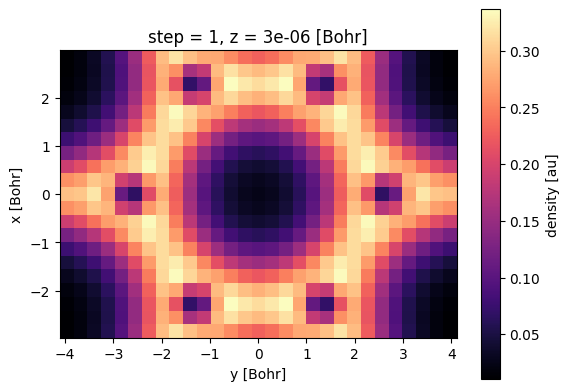

In [55]:
fig, ax = plt.subplots()
s3.plot.imshow(ax=ax, cmap="magma")
ax.set_aspect("equal")



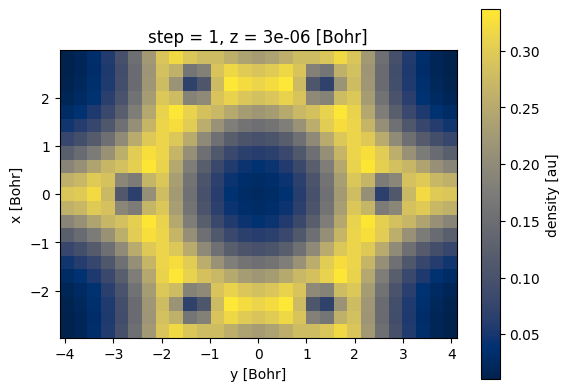

In [56]:
fig, ax = plt.subplots()
s3.plot.imshow(ax=ax, cmap="cividis")
ax.set_aspect("equal")

fig.savefig("test.pdf")



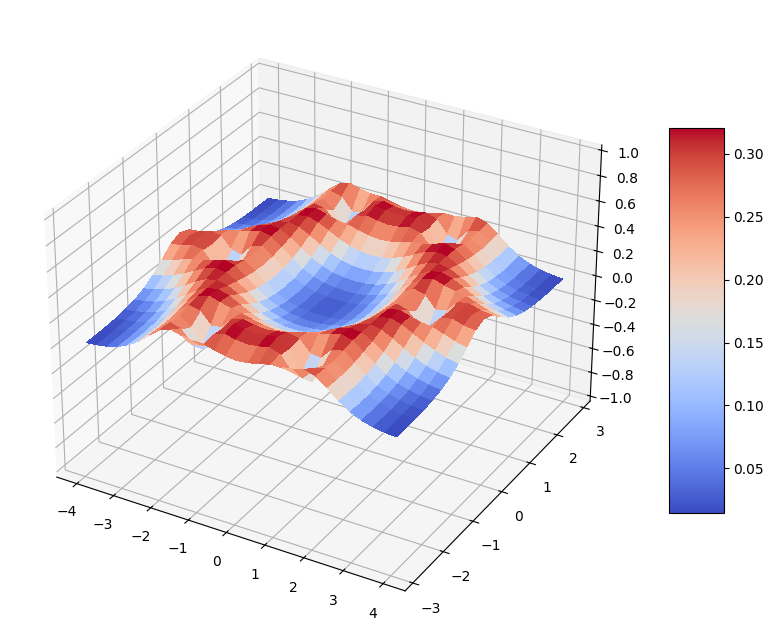

In [57]:
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator
import numpy as np

fig, ax = plt.subplots(subplot_kw={"projection": "3d"}, figsize=(10, 10))

# Make data.

z = s3
x = z.coords["x"].values
y = z.coords["y"].values

Y, X = np.meshgrid(x, y, indexing="ij")
Z = z.values

# Plot the surface.
surf = ax.plot_surface(X, Y, Z, cmap=cm.coolwarm, linewidth=0, antialiased=False)

# Customize the z axis.
ax.set_zlim(-1, 1)
ax.zaxis.set_major_locator(LinearLocator(11))

# Add a color bar which maps values to colors.
fig.colorbar(surf, shrink=0.5, aspect=7)

plt.show()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
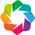

<xarray.DataArray 'density' (step: 1, x: 95, y: 99, z: 67)>
array([[[[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
...
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]]]])
Coordinates:
  * step     (step) int64 1
  * x        (x) float64 -13.32 -13.04 -12.76 -12.47 ... 12.47 12.76 13.04 13.32
  * y        (y) float64 -13.89 -13.61 -13.32 -13.04 ... 13.04 13.32 13.61 13.89
  * z        (z) float64 -9.354 -9.071 -8.787 -8.504 ... 8.504 8.787 9.071 9.354
Attributes:
    units:    au

In [58]:
import holoviews as hv
from holoviews import opts  # For setting defaults

hv.extension("bokeh", "matplotlib")  # Allow for interactive plots
xa = run.default.scf.density.get_converged(source="cube")  # postopus XArray
xa



In [59]:
hv_ds = hv.Dataset(xa)
hv_im = hv_ds.to(hv.Image, kdims=["x", "y"])
hv_im

:HoloMap   [step,z]
   :Image   [x,y]   (density)

In [60]:
hv_im.data  # one can see here that each of the samples within the Holomap is an Image

{(1, -9.354144): :Image   [x,y]   (density),
 (1, -9.070685): :Image   [x,y]   (density),
 (1, -8.787226): :Image   [x,y]   (density),
 (1, -8.503767): :Image   [x,y]   (density),
 (1, -8.220308): :Image   [x,y]   (density),
 (1, -7.936849): :Image   [x,y]   (density),
 (1, -7.65339): :Image   [x,y]   (density),
 (1, -7.369930999999999): :Image   [x,y]   (density),
 (1, -7.086472): :Image   [x,y]   (density),
 (1, -6.803013): :Image   [x,y]   (density),
 (1, -6.519553999999999): :Image   [x,y]   (density),
 (1, -6.236095): :Image   [x,y]   (density),
 (1, -5.952636): :Image   [x,y]   (density),
 (1, -5.6691769999999995): :Image   [x,y]   (density),
 (1, -5.385718): :Image   [x,y]   (density),
 (1, -5.102258999999999): :Image   [x,y]   (density),
 (1, -4.8187999999999995): :Image   [x,y]   (density),
 (1, -4.535341): :Image   [x,y]   (density),
 (1, -4.251881999999999): :Image   [x,y]   (density),
 (1, -3.9684229999999996): :Image   [x,y]   (density),
 (1, -3.684963999999999): :Image   

In [61]:
hv_im.opts(opts.Image(title="title"))  # Sets specific opts for a single plot

:HoloMap   [step,z]
   :Image   [x,y]   (density)

In [62]:
os.chdir(r'/home/robert/Documents/Test/PostoPus/Methane')

In [80]:
run = Run(".")
xat = run.default.scf.density.get_all(source="vtk")  # XArray Time-dependent

In [81]:
hv_dst = hv.Dataset(xat)  # convert to holoviews Dataset
hv_imt = hv_dst.to(hv.Image)  # convert to holoviews Image
hv.output(
    max_frames=10000
)  # sets the max number of frames that we can have in a slider-plot

In [82]:
hv_dst = hv.Dataset(xat)
hv_imt = hv_dst.to(hv.Image, kdims=["x", "y"], dynamic=True)
hv.output(max_frames=10000)

In [83]:
hv_im

:HoloMap   [step,z]
   :Image   [x,y]   (density)

In [84]:
# Note for web users: You should have an active notebook session to interact with the plot
hv_imt.hist(num_bins=100, log=True).opts(
    opts.Image(
        colorbar=True,  # we set the opts for each hv object independently
        clabel=f"{xat.name} ({xat.units})",
    ),  # holoviews doesn't support the labeling of the cmap out of the box
    opts.Histogram(xlim=(0, 0.5), ylim=(0, 50)),
)  # use base 10 logarithmic samples for the bin edges (width)



ModuleNotFoundError: No module named 'jupyter_bokeh'

:AdjointLayout
   :DynamicMap   [step,z]
   :DynamicMap   [step,z]